# Introduction

**Uber** and **Lyft** are both ride-hailing services that connect customers and drivers via their individual platforms- which are available on mobile and website applications. **Uber** is the larger of the two companies, and is concedered as the industry leader - they operate globally with operations in **72** countries and **10,500** cities. As of 2024, Uber has **131 million** active users with **23 million** rides per day on average and **7.64 billion** trips per year.  **Lyft** operates in North America, in **644** cities in the United States and **17** cities in Canada. Uber and lyft are competitors in the US rideshare market and they compete through different strategies and features. Uber dominates the US rideshare market with its closest competitor being Lyft.

The two companies offer alternative transportation solutions compared to the traditional taxis and cab hailing services. The following are some of the ways in which they compete:
1. Pricing models
2. Market share
3. Service offerings
4. Driver and passenger experience

The dataset used in this problem has Uber and Lyft ride-hailing data from Boston (US). Since the prices of ride-hailing services fluctuate unlike traditional public transport, let's investigate the dataset to see how prices of the two competitors are related to other factors including weather, trip duration, etc.


## Dataset
The **Uber & Lyft Cab Prices**  dataset was downloaded from [Kaggle.com](https://www.kaggle.com/datasets/ravi72munde/uber-lyft-cab-prices). Uber and Lyft do not make their ride datasets available to the public, therefore this dataset was collected by querying Uber and Lyft APIs and also corresponding weather conditions. For more information on how the dataset was collected please see the [Github project](https://github.com/ravi72munde/scala-spark-cab-rides-predictions).

### Objective
The dataset was created to investigate the factors that determine the price for an Uber or Lyft trip.

## Import Libraries


In [ ]:
import os

from google.colab import auth
import gspread
from google.auth import default

import pandas as pd
import numpy as np
import seaborn as sns

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go

from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from matplotlib import pyplot as plt
import warnings
import datetime
from openpyxl.utils.dataframe import dataframe_to_rows
from openpyxl import load_workbook
%matplotlib inline
warnings.filterwarnings('ignore')

In [ ]:
def get_dataset_dir(dataset):
  # get current working dir
  cwd = os.getcwd()
  # get drive path
  drive_path = "/drive/MyDrive/"
  # dataset path
  dataset_path = "/datasets/"
  # dataset dir
  dataset_dir = cwd + drive_path + dataset_path + dataset

  return dataset_dir



### Styling variables


In [ ]:
lyft_pink = "#FF00BF"

In [ ]:
def missing_plot(missing_series, len_df):
  missing_index = missing_series.index
  missing_value_per_cent = [(val/len_df)*100 for val in missing_series.values]

  fig = go.Figure(
    data = go.Bar(
        x= missing_index,
        y=missing_value_per_cent))
  fig.update_layout(
      plot_bgcolor="white",
      height=450,
      width=450,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Missing value % <br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      xaxis_title="dataset variables",
      showlegend=False
  )
  fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
  fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
  fig.show()

In [ ]:
# load in the dataset
dataset_path = "Cab-Weather Data/raw"
data_dir = get_dataset_dir(dataset_path)
os.listdir(data_dir)


['cab_rides.txt', 'weather.txt']

In [ ]:
# load in the raw datasets
cab_raw = pd.read_csv(data_dir+"/cab_rides.txt", sep=",", encoding="utf-16")
# show the first 5 observations
cab_raw.head()

In [ ]:
cab_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693071 entries, 0 to 693070
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   distance          693071 non-null  float64
 1   cab_type          693071 non-null  object 
 2   time_stamp        693071 non-null  int64  
 3   destination       693071 non-null  object 
 4   source            693071 non-null  object 
 5   price             637976 non-null  float64
 6   surge_multiplier  693071 non-null  float64
 7   id                693071 non-null  object 
 8   product_id        693071 non-null  object 
 9   name              693071 non-null  object 
dtypes: float64(3), int64(1), object(6)
memory usage: 52.9+ MB


- **prices** is the only column with missing values

In [ ]:
# load weather
wth_raw = pd.read_csv(data_dir+"/weather.txt", sep=",", encoding="utf-16")
# show first 5 observations
wth_raw.head()

,temp,location,clouds,pressure,rain,time_stamp,humidity,wind
0,42.42,Back Bay,1.0,1012.14,0.1228,1545003901,0.77,11.25
1,42.43,Beacon Hill,1.0,1012.15,0.1846,1545003901,0.76,11.32
2,42.50,Boston University,1.0,1012.15,0.1089,1545003901,0.76,11.07
3,42.11,Fenway,1.0,1012.13,0.0969,1545003901,0.77,11.09
4,43.13,Financial District,1.0,1012.14,0.1786,1545003901,0.75,11.49


In [ ]:
wth_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6276 entries, 0 to 6275
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   temp        6276 non-null   float64
 1   location    6276 non-null   object 
 2   clouds      6276 non-null   float64
 3   pressure    6276 non-null   float64
 4   rain        894 non-null    float64
 5   time_stamp  6276 non-null   int64  
 6   humidity    6276 non-null   float64
 7   wind        6276 non-null   float64
dtypes: float64(6), int64(1), object(1)
memory usage: 392.4+ KB


- **rain** only column with missing values

## Data Cleaning

- Cab datasets

In [ ]:
cab_missing = cab_raw.isnull().sum().sort_values()
cab_missing

distance                0
cab_type                0
time_stamp              0
destination             0
source                  0
surge_multiplier        0
id                      0
product_id              0
name                    0
price               55095
dtype: int64

**price** is the only column with missing values and there 55095 observations with missing values.

In [ ]:
# calculate the number of observations in cab_raw df
len_cab = cab_raw.shape[0]

In [ ]:
missing_plot(cab_missing, len_cab)

- missing values in price column are less than **10%** of the total dataset size
- we can drop these missing observations (we are trying to predict prices, so a performing fill operations will influence the price distribution).

In [ ]:
# drop
cab_raw = cab_raw.dropna(axis=0).reset_index(drop=True)
cab_raw

,distance,cab_type,time_stamp,destination,source,price,surge_multiplier,id,product_id,name
0,0.44,Lyft,1544952607890,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared
1,0.44,Lyft,1544952607890,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux
2,0.44,Lyft,1544952607890,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft
3,0.44,Lyft,1544952607890,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL
4,0.44,Lyft,1544952607890,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL
...,...,...,...,...,...,...,...,...,...,...
637971,1.00,Uber,1543708385534,North End,West End,9.5,1.0,353e6566-b272-479e-a9c6-98bd6cb23f25,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV
637972,1.00,Uber,1543708385534,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL
637973,1.00,Uber,1543708385534,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX
637974,1.00,Uber,1543708385534,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV


- weather dataset

In [ ]:
wth_missing = wth_raw.isnull().sum().sort_values()
wth_missing

temp             0
location         0
clouds           0
pressure         0
time_stamp       0
humidity         0
wind             0
rain          5382
dtype: int64

- **rain** is the only column with missing values. There are 5382 observations missing.

In [ ]:
# calculate the number of observations in the wth_raw df
len_wth = wth_raw.shape[0]

In [ ]:
missing_plot(wth_missing, len_wth)

- **rain** column values that are missing are replaced with zero.
- **assumption** - no rain indicates 0

In [ ]:
# fill in rain na observations with zero
wth_raw["rain"] = wth_raw["rain"].fillna(0)
wth_raw

,temp,location,clouds,pressure,rain,time_stamp,humidity,wind
0,42.42,Back Bay,1.00,1012.14,0.1228,1545003901,0.77,11.25
1,42.43,Beacon Hill,1.00,1012.15,0.1846,1545003901,0.76,11.32
2,42.50,Boston University,1.00,1012.15,0.1089,1545003901,0.76,11.07
3,42.11,Fenway,1.00,1012.13,0.0969,1545003901,0.77,11.09
4,43.13,Financial District,1.00,1012.14,0.1786,1545003901,0.75,11.49
...,...,...,...,...,...,...,...,...
6271,44.72,North Station,0.89,1000.69,0.0000,1543819974,0.96,1.52
6272,44.85,Northeastern University,0.88,1000.71,0.0000,1543819974,0.96,1.54
6273,44.82,South Station,0.89,1000.70,0.0000,1543819974,0.96,1.54
6274,44.78,Theatre District,0.89,1000.70,0.0000,1543819974,0.96,1.54


### Merging Datasets
Merge the two datasets based on
- cab location
- cab time stamp

The timestamp from the `cab_raw` dataframe contains more information than the timestamp from the `wth_raw` dataframe.  Therefore we can create a temporary column which we can join on based on time and location. The format of the column used to joing will be

> **location-date-hour**





In [ ]:
# convert time_stamp columns to datetime
# timestamp for cab rides has epoch up to mili seconds
cab_raw["timestamp"] = pd.to_datetime(cab_raw["time_stamp"], unit="ms")
# drop time_stamp
cab_raw = cab_raw.drop("time_stamp", axis=1)
# cab_raw["timestamp"] = cab_raw["timestamp"].dt.strftime("%Y-%m-%d:%H:%M:%S")
cab_raw


,distance,cab_type,destination,source,price,surge_multiplier,id,product_id,name,timestamp
0,0.44,Lyft,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared,2018-12-16 09:30:07.890
1,0.44,Lyft,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux,2018-12-16 09:30:07.890
2,0.44,Lyft,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft,2018-12-16 09:30:07.890
3,0.44,Lyft,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL,2018-12-16 09:30:07.890
4,0.44,Lyft,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL,2018-12-16 09:30:07.890
...,...,...,...,...,...,...,...,...,...,...
637971,1.00,Uber,North End,West End,9.5,1.0,353e6566-b272-479e-a9c6-98bd6cb23f25,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-12-01 23:53:05.534
637972,1.00,Uber,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL,2018-12-01 23:53:05.534
637973,1.00,Uber,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX,2018-12-01 23:53:05.534
637974,1.00,Uber,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV,2018-12-01 23:53:05.534


In [ ]:
# create merge_date
cab_raw["trip_date"] = cab_raw["source"].astype(str) + "-"+ cab_raw["timestamp"].dt.date.astype(str) + "-" + cab_raw["timestamp"].dt.hour.astype(str)
cab_raw["trip_date"]

0         Haymarket Square-2018-12-16-9
1         Haymarket Square-2018-12-16-9
2         Haymarket Square-2018-12-16-9
3         Haymarket Square-2018-12-16-9
4         Haymarket Square-2018-12-16-9
                      ...              
637971           West End-2018-12-01-23
637972           West End-2018-12-01-23
637973           West End-2018-12-01-23
637974           West End-2018-12-01-23
637975           West End-2018-12-01-23
Name: trip_date, Length: 637976, dtype: object

In [ ]:
# timestamp for weather set has epoch up to seconds
wth_raw["timestamp"] = pd.to_datetime(wth_raw["time_stamp"], unit="s")
# drop time_stamp
wth_raw = wth_raw.drop("time_stamp", axis=1)
# wth_raw["timestamp"] = wth_raw["timestamp"].dt.strftime("%Y-%m-%d:%H:%M:%S")
wth_raw

,temp,location,clouds,pressure,rain,humidity,wind,timestamp
0,42.42,Back Bay,1.00,1012.14,0.1228,0.77,11.25,2018-12-16 23:45:01
1,42.43,Beacon Hill,1.00,1012.15,0.1846,0.76,11.32,2018-12-16 23:45:01
2,42.50,Boston University,1.00,1012.15,0.1089,0.76,11.07,2018-12-16 23:45:01
3,42.11,Fenway,1.00,1012.13,0.0969,0.77,11.09,2018-12-16 23:45:01
4,43.13,Financial District,1.00,1012.14,0.1786,0.75,11.49,2018-12-16 23:45:01
...,...,...,...,...,...,...,...,...
6271,44.72,North Station,0.89,1000.69,0.0000,0.96,1.52,2018-12-03 06:52:54
6272,44.85,Northeastern University,0.88,1000.71,0.0000,0.96,1.54,2018-12-03 06:52:54
6273,44.82,South Station,0.89,1000.70,0.0000,0.96,1.54,2018-12-03 06:52:54
6274,44.78,Theatre District,0.89,1000.70,0.0000,0.96,1.54,2018-12-03 06:52:54


In [ ]:
wth_raw["trip_date"] = wth_raw["location"].astype(str) + "-"+ wth_raw["timestamp"].dt.date.astype(str) + "-" + wth_raw["timestamp"].dt.hour.astype(str)
wth_raw["trip_date"]

0                     Back Bay-2018-12-16-23
1                  Beacon Hill-2018-12-16-23
2            Boston University-2018-12-16-23
3                       Fenway-2018-12-16-23
4           Financial District-2018-12-16-23
                        ...                 
6271              North Station-2018-12-03-6
6272    Northeastern University-2018-12-03-6
6273              South Station-2018-12-03-6
6274           Theatre District-2018-12-03-6
6275                   West End-2018-12-03-6
Name: trip_date, Length: 6276, dtype: object

Let us investigate the columns in which we want to use to join
- source (cab_raw)


In [ ]:
(cab_raw["source"].
 unique())

array(['Haymarket Square', 'Back Bay', 'North End', 'North Station',
       'Beacon Hill', 'Boston University', 'Fenway', 'South Station',
       'Theatre District', 'West End', 'Financial District',
       'Northeastern University'], dtype=object)

- location (wth_raw)

In [ ]:
(wth_raw["location"]
 .unique())

array(['Back Bay', 'Beacon Hill', 'Boston University', 'Fenway',
       'Financial District', 'Haymarket Square', 'North End',
       'North Station', 'Northeastern University', 'South Station',
       'Theatre District', 'West End'], dtype=object)

In [ ]:
rides_df = cab_raw.merge(wth_raw,how="left",on=["trip_date"])
rides_df

,distance,cab_type,destination,source,price,surge_multiplier,id,product_id,name,timestamp_x,trip_date,temp,location,clouds,pressure,rain,humidity,wind,timestamp_y
0,0.44,Lyft,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
1,0.44,Lyft,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
2,0.44,Lyft,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
3,0.44,Lyft,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
4,0.44,Lyft,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1165279,1.00,Uber,North End,West End,9.5,1.0,353e6566-b272-479e-a9c6-98bd6cb23f25,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55
1165280,1.00,Uber,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55
1165281,1.00,Uber,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55
1165282,1.00,Uber,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55


<Axes: >

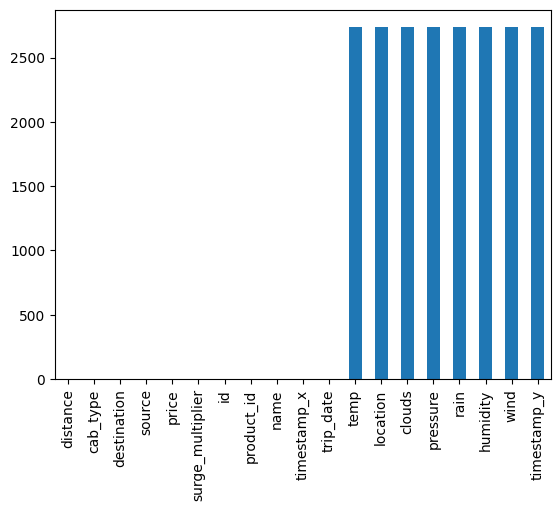

In [ ]:
(rides_df
 .isnull()
 .sum()
 .plot(kind="bar")
 )

- There are now **1165284** observations in the merged dataframe which is more than the original `cab_raw` dataframe (637976).
- Let us use the **id** column to remove the duplicates.

In [ ]:
(rides_df
 .isnull()
 .sum())

distance               0
cab_type               0
destination            0
source                 0
price                  0
surge_multiplier       0
id                     0
product_id             0
name                   0
timestamp_x            0
trip_date              0
temp                2736
location            2736
clouds              2736
pressure            2736
rain                2736
humidity            2736
wind                2736
timestamp_y         2736
dtype: int64

In [ ]:
rides_df = rides_df.dropna(axis=0).reset_index(drop=True)
rides_df

,distance,cab_type,destination,source,price,surge_multiplier,id,product_id,name,timestamp_x,trip_date,temp,location,clouds,pressure,rain,humidity,wind,timestamp_y
0,0.44,Lyft,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
1,0.44,Lyft,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
2,0.44,Lyft,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
3,0.44,Lyft,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
4,0.44,Lyft,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL,2018-12-16 09:30:07.890,Haymarket Square-2018-12-16-9,38.46,Haymarket Square,0.29,1022.25,0.0,0.76,7.68,2018-12-16 09:45:01
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1162543,1.00,Uber,North End,West End,9.5,1.0,353e6566-b272-479e-a9c6-98bd6cb23f25,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55
1162544,1.00,Uber,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55
1162545,1.00,Uber,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55
1162546,1.00,Uber,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV,2018-12-01 23:53:05.534,West End-2018-12-01-23,36.69,West End,0.41,1023.64,0.0,0.76,2.51,2018-12-01 23:52:55


In [ ]:
# lets look at duplicated
rides_df[rides_df.duplicated(["id"], keep=False)]

,distance,cab_type,destination,source,price,surge_multiplier,id,product_id,name,timestamp_x,trip_date,temp,location,clouds,pressure,rain,humidity,wind,timestamp_y
6,1.08,Lyft,Northeastern University,Back Bay,10.5,1.0,462816a3-820d-408b-8549-0b39e82f65ac,lyft_plus,Lyft XL,2018-11-27 02:00:23.677,Back Bay-2018-11-27-2,43.84,Back Bay,0.99,1002.56,0.1470,0.89,11.30,2018-11-27 02:45:20
7,1.08,Lyft,Northeastern University,Back Bay,10.5,1.0,462816a3-820d-408b-8549-0b39e82f65ac,lyft_plus,Lyft XL,2018-11-27 02:00:23.677,Back Bay-2018-11-27-2,44.32,Back Bay,1.00,1003.12,0.1144,0.90,13.64,2018-11-27 02:15:22
8,1.08,Lyft,Northeastern University,Back Bay,16.5,1.0,474d6376-bc59-4ec9-bf57-4e6d6faeb165,lyft_lux,Lux Black,2018-11-27 02:00:23.677,Back Bay-2018-11-27-2,43.84,Back Bay,0.99,1002.56,0.1470,0.89,11.30,2018-11-27 02:45:20
9,1.08,Lyft,Northeastern University,Back Bay,16.5,1.0,474d6376-bc59-4ec9-bf57-4e6d6faeb165,lyft_lux,Lux Black,2018-11-27 02:00:23.677,Back Bay-2018-11-27-2,44.32,Back Bay,1.00,1003.12,0.1144,0.90,13.64,2018-11-27 02:15:22
10,1.08,Lyft,Northeastern University,Back Bay,3.0,1.0,4f9fee41-fde3-4767-bbf1-a00e108701fb,lyft_line,Shared,2018-11-27 02:00:23.677,Back Bay-2018-11-27-2,43.84,Back Bay,0.99,1002.56,0.1470,0.89,11.30,2018-11-27 02:45:20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1162531,0.91,Uber,Beacon Hill,Haymarket Square,7.0,1.0,d1a50035-184d-4e63-8aa1-813b497e293e,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-11-29 01:47:08.123,Haymarket Square-2018-11-29-1,38.50,Haymarket Square,0.55,997.77,0.0000,0.70,10.30,2018-11-29 01:59:51
1162532,0.91,Uber,Beacon Hill,Haymarket Square,7.0,1.0,d1a50035-184d-4e63-8aa1-813b497e293e,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-11-29 01:47:08.123,Haymarket Square-2018-11-29-1,38.69,Haymarket Square,0.70,997.11,0.0000,0.71,9.95,2018-11-29 01:02:08
1162533,0.91,Uber,Beacon Hill,Haymarket Square,7.0,1.0,d1a50035-184d-4e63-8aa1-813b497e293e,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-11-29 01:47:08.123,Haymarket Square-2018-11-29-1,38.58,Haymarket Square,0.67,997.22,0.0000,0.71,10.10,2018-11-29 01:09:23
1162534,0.91,Uber,Beacon Hill,Haymarket Square,7.0,1.0,d1a50035-184d-4e63-8aa1-813b497e293e,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-11-29 01:47:08.123,Haymarket Square-2018-11-29-1,38.31,Haymarket Square,0.58,997.47,0.0000,0.72,10.48,2018-11-29 01:27:03


- There are duplicates because of the weather timestamp has more than one observation that matches the format used in **trip date**.
Lets us remove the duplicates.
- The time stamp from the ride is more important to us.

In [ ]:
rides_df = rides_df.drop_duplicates("id",keep="first").reset_index(drop=True)
rides_df.shape

(635240, 19)

- lets remove and rename the following columns
  - timestamp_y (**remove**)
  - timestamp_x (**rename**)

In [ ]:
# remove timestamp_y
# rides_df = rides_df.drop("timestamp_y", axis=1)
# rename timestamp_x
rides_df = (rides_df
            .drop(
                ["timestamp_y","trip_date","location"], axis=1)
            .rename(
                columns={"timestamp_x":"timestamp"}
            ))
rides_df

,distance,cab_type,destination,source,price,surge_multiplier,id,product_id,name,timestamp,temp,clouds,pressure,rain,humidity,wind
0,0.44,Lyft,North Station,Haymarket Square,5.0,1.0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,lyft_line,Shared,2018-12-16 09:30:07.890,38.46,0.29,1022.25,0.0,0.76,7.68
1,0.44,Lyft,North Station,Haymarket Square,11.0,1.0,4bd23055-6827-41c6-b23b-3c491f24e74d,lyft_premier,Lux,2018-12-16 09:30:07.890,38.46,0.29,1022.25,0.0,0.76,7.68
2,0.44,Lyft,North Station,Haymarket Square,7.0,1.0,981a3613-77af-4620-a42a-0c0866077d1e,lyft,Lyft,2018-12-16 09:30:07.890,38.46,0.29,1022.25,0.0,0.76,7.68
3,0.44,Lyft,North Station,Haymarket Square,26.0,1.0,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,lyft_luxsuv,Lux Black XL,2018-12-16 09:30:07.890,38.46,0.29,1022.25,0.0,0.76,7.68
4,0.44,Lyft,North Station,Haymarket Square,9.0,1.0,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,lyft_plus,Lyft XL,2018-12-16 09:30:07.890,38.46,0.29,1022.25,0.0,0.76,7.68
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
635235,1.00,Uber,North End,West End,9.5,1.0,353e6566-b272-479e-a9c6-98bd6cb23f25,9a0e7b09-b92b-4c41-9779-2ad22b4d779d,WAV,2018-12-01 23:53:05.534,36.69,0.41,1023.64,0.0,0.76,2.51
635236,1.00,Uber,North End,West End,13.0,1.0,616d3611-1820-450a-9845-a9ff304a4842,6f72dfc5-27f1-42e8-84db-ccc7a75f6969,UberXL,2018-12-01 23:53:05.534,36.69,0.41,1023.64,0.0,0.76,2.51
635237,1.00,Uber,North End,West End,9.5,1.0,633a3fc3-1f86-4b9e-9d48-2b7132112341,55c66225-fbe7-4fd5-9072-eab1ece5e23e,UberX,2018-12-01 23:53:05.534,36.69,0.41,1023.64,0.0,0.76,2.51
635238,1.00,Uber,North End,West End,27.0,1.0,727e5f07-a96b-4ad1-a2c7-9abc3ad55b4e,6d318bcc-22a3-4af6-bddd-b409bfce1546,Black SUV,2018-12-01 23:53:05.534,36.69,0.41,1023.64,0.0,0.76,2.51


- add some time features based on time stamp to dataframe

In [ ]:
rides_df = (rides_df
            .assign(
                hour  = rides_df.timestamp.dt.hour,
                dayOfWeek = rides_df.timestamp.dt.dayofweek,
                month= rides_df.timestamp.dt.month


            ))

- lets look at the unique values across the dataframe

<Axes: >

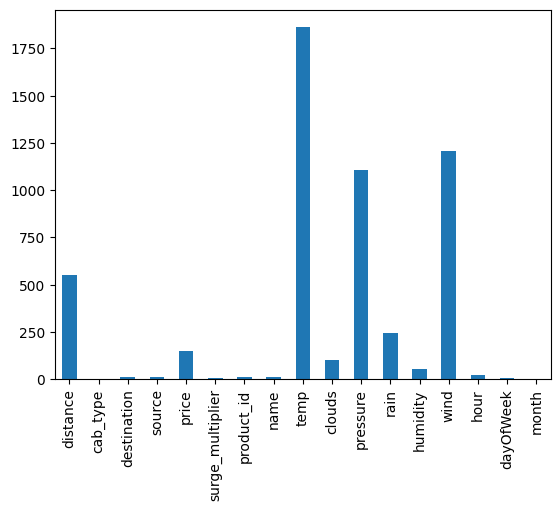

In [ ]:
(rides_df
 .drop(["id","timestamp"], axis=1)
 .nunique()
 .plot(kind="bar")
 )

<Axes: >

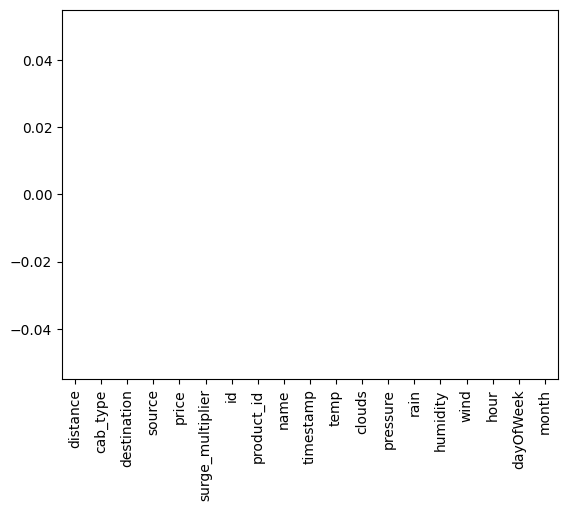

In [ ]:
(rides_df
 .isnull()
 .sum()
 .plot(kind="bar")
 )

# EDA

In this section, we dig into the dataset to get a better understanding of the relationship between the variables and their relationship to our target variable **price**.


- Check count of trips from each ride hailing provider

In [ ]:
df = rides_df.copy()

In [ ]:
df["cab_type"].value_counts()

Uber    329200
Lyft    306040
Name: cab_type, dtype: int64

- dataset is approximately evenly distributed with Uber having ~**30000** more observations.
- lets determine the type of products offered by each service provider

In [ ]:
#
colors = [lyft_pink, "black"]
cab_trip_count = df.groupby("cab_type")["product_id"].count()
fig = go.Figure()
fig.add_trace(
    go.Bar(x=cab_trip_count.index, y= cab_trip_count.values, text=cab_trip_count.values, marker_color=colors)
)
fig.update_layout(
      plot_bgcolor="white",
      height=450,
      width=450,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Dataset Distribution <br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      xaxis_title="Ride Provider",
      showlegend=False
  )
fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.show()

In [ ]:
(df[df["cab_type"]=="Uber"]
 .pivot_table(
     index="source", columns="destination",values = "distance"
 )).fillna(0)

destination,Back Bay,Beacon Hill,Boston University,Fenway,Financial District,Haymarket Square,North End,North Station,Northeastern University,South Station,Theatre District,West End
source,,,,,,,,,,,,
Back Bay,0.000000,0.000000,1.388929,1.340054,0.000000,2.417781,2.959283,0.000000,1.168228,3.629114,0.000000,0.000000
Beacon Hill,0.000000,0.000000,2.264596,2.318032,0.000000,1.344499,1.808436,0.000000,2.086597,2.294391,0.000000,0.000000
Boston University,1.523481,2.798452,0.000000,0.000000,4.606996,0.000000,0.000000,3.377052,0.000000,0.000000,2.855740,3.055763
Fenway,1.513922,2.498380,0.000000,0.000000,4.348110,0.000000,0.000000,3.072965,0.000000,0.000000,2.573741,2.750998
Financial District,0.000000,0.000000,5.159389,4.481793,0.000000,1.207612,1.204395,0.000000,4.483892,0.393411,0.000000,0.000000
Haymarket Square,2.128930,1.105989,0.000000,0.000000,0.951219,0.000000,0.000000,0.494190,0.000000,0.000000,1.179930,0.623733
North End,2.770272,1.884819,0.000000,0.000000,1.077796,0.000000,0.000000,0.983314,0.000000,0.000000,1.423333,1.162097
North Station,0.000000,0.000000,3.007510,3.047805,0.000000,0.588276,1.081522,0.000000,3.292824,2.044199,0.000000,0.000000
Northeastern University,1.596931,2.620541,0.000000,0.000000,4.441146,0.000000,0.000000,3.206023,0.000000,0.000000,2.049256,2.886887


- view distribution of distance travelled by each ride service provider

In [ ]:
fig = px.box(df, x="cab_type", y="distance")
fig.update_layout(
      plot_bgcolor="white",
      height=450,
      width=450,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Distance Distribution <br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      xaxis_title="Ride Provider",
      showlegend=False
  )
fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.show()


- let us plot the distribution of price per ride provider - *assumption- price includes surge multiplier*

In [ ]:
fig = px.box(df, x="cab_type", y="price")
fig.update_layout(
      plot_bgcolor="white",
      height=450,
      width=450,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Price Distribution <br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      xaxis_title="Ride Provider",
      showlegend=False
  )
fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.show()

- let us plot the distance from trip source to trip destination using a heatmap

In [ ]:

uber_trips = (df[df["cab_type"]=="Uber"]
 .pivot_table(
     index="source", columns="destination",values = "distance"
 )).fillna(0).round(1)

uber_trips

destination,Back Bay,Beacon Hill,Boston University,Fenway,Financial District,Haymarket Square,North End,North Station,Northeastern University,South Station,Theatre District,West End
source,,,,,,,,,,,,
Back Bay,0.0,0.0,1.4,1.3,0.0,2.4,3.0,0.0,1.2,3.6,0.0,0.0
Beacon Hill,0.0,0.0,2.3,2.3,0.0,1.3,1.8,0.0,2.1,2.3,0.0,0.0
Boston University,1.5,2.8,0.0,0.0,4.6,0.0,0.0,3.4,0.0,0.0,2.9,3.1
Fenway,1.5,2.5,0.0,0.0,4.3,0.0,0.0,3.1,0.0,0.0,2.6,2.8
Financial District,0.0,0.0,5.2,4.5,0.0,1.2,1.2,0.0,4.5,0.4,0.0,0.0
Haymarket Square,2.1,1.1,0.0,0.0,1.0,0.0,0.0,0.5,0.0,0.0,1.2,0.6
North End,2.8,1.9,0.0,0.0,1.1,0.0,0.0,1.0,0.0,0.0,1.4,1.2
North Station,0.0,0.0,3.0,3.0,0.0,0.6,1.1,0.0,3.3,2.0,0.0,0.0
Northeastern University,1.6,2.6,0.0,0.0,4.4,0.0,0.0,3.2,0.0,0.0,2.0,2.9


In [ ]:
fig = px.imshow(uber_trips, text_auto = True)
fig.show()

In [ ]:
lyft_trips = (df[df["cab_type"]=="Lyft"]
 .pivot_table(
     index="source", columns="destination",values = "distance"
 )).fillna(0).round(1)

lyft_trips


destination,Back Bay,Beacon Hill,Boston University,Fenway,Financial District,Haymarket Square,North End,North Station,Northeastern University,South Station,Theatre District,West End
source,,,,,,,,,,,,
Back Bay,0.0,0.0,1.5,1.4,0.0,2.3,2.7,0.0,1.1,1.6,0.0,0.0
Beacon Hill,0.0,0.0,2.3,2.4,0.0,1.4,1.8,0.0,2.4,2.1,0.0,0.0
Boston University,1.6,2.7,0.0,0.0,4.5,0.0,0.0,3.5,0.0,0.0,3.0,3.1
Fenway,1.5,2.4,0.0,0.0,4.2,0.0,0.0,3.2,0.0,0.0,2.7,2.8
Financial District,0.0,0.0,5.2,4.5,0.0,1.1,1.2,0.0,3.5,0.4,0.0,0.0
Haymarket Square,2.3,1.3,0.0,0.0,1.0,0.0,0.0,0.5,0.0,0.0,1.3,0.7
North End,2.9,1.9,0.0,0.0,1.1,0.0,0.0,1.1,0.0,0.0,1.6,1.2
North Station,0.0,0.0,3.1,3.2,0.0,0.7,1.1,0.0,3.3,2.0,0.0,0.0
Northeastern University,1.4,2.4,0.0,0.0,3.8,0.0,0.0,3.2,0.0,0.0,2.1,2.8


In [ ]:
fig = px.imshow(lyft_trips, text_auto=True)
fig.show()

- one would assume that the distance between the two locations will be the same for each ride service, however we can see from the two plots above that there is a difference in the distance.

- let us look at trip distributions as a funtion of dateTime: count the number of rides by time for Uber and Lyft

In [ ]:
hourly_trip = (df
               .groupby(["hour","cab_type"])["id"]
               .count()
               .unstack())
daily_trip = (df
               .groupby(["dayOfWeek","cab_type"])["id"]
               .count()
               .unstack())
monthly_trip = (df
               .groupby(["month","cab_type"])["id"]
               .count()
               .unstack())

KeyError: 'hour'

In [ ]:
daily_trip

In [ ]:
monthly_trip

In [ ]:
fig = make_subplots(3,1,
                   subplot_titles=(
                     "Trip distribution by hour",
                     "Trip distribution by day",
                     "Trip distribution by Month"
                        )
                   )
# hourly
# lyft
fig.add_trace(
    go.Bar(name="hourly trip count [Lyft]", x = hourly_trip.index, y=hourly_trip["Lyft"],
           marker_color=lyft_pink), row=1, col=1
)
# uber
fig.add_trace(
    go.Bar(name="hourly trip count [Uber]", x = hourly_trip.index, y=hourly_trip["Uber"],
           marker_color="black"), row=1, col=1
)
# ====================
# dayofweek
# lyft
fig.add_trace(
    go.Bar(name="week day trip count [Lyft]", x = daily_trip.index, y=daily_trip["Lyft"],
           marker_color=lyft_pink), row=2, col=1
)
# uber
fig.add_trace(
    go.Bar(name="week day trip count [Uber]", x = daily_trip.index, y=daily_trip["Uber"],
           marker_color="black"), row=2, col=1
)
# #=========================
# Month
# lyft
fig.add_trace(
    go.Bar(name="month trip count [Lyft]", x = monthly_trip.index, y=monthly_trip["Lyft"],
           marker_color=lyft_pink), row=3, col=1
)
# uber
fig.add_trace(
    go.Bar(name="month trip count [Lyft]", x = monthly_trip.index, y=monthly_trip["Uber"],
           marker_color="black"), row=3, col=1
)
fig.update_layout(
      barmode='stack',
      plot_bgcolor="white",
      height=900,
      width=950,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Trip Distribution by Time Frame<br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      # xaxis_title="Ride Provider",
      showlegend=False
  )
fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.show()

- Lets plot trip distribution by location
  - Source location
  - Destination location

In [ ]:
source_trip = (df
               .groupby(["source","cab_type"])["id"]
               .count()
               .unstack())
source_trip

In [ ]:
dest_trip = (df
               .groupby(["destination","cab_type"])["id"]
               .count()
               .unstack())
dest_trip

cab_type,Lyft,Uber
destination,,
Back Bay,25518,27408
Beacon Hill,25374,27286
Boston University,25500,27443
Fenway,25506,27432
Financial District,26148,27864
Haymarket Square,25499,27444
North End,25500,27436
North Station,25200,27125
Northeastern University,25505,27432


In [ ]:
fig = make_subplots(1,2,
                   subplot_titles=(
                     "Trip distribution by source location",
                     "Trip distribution by destination location",
                        )
                   )
# Trip  source
# lyft
fig.add_trace(
    go.Bar(name="source trip count [Lyft]", x = source_trip.index, y=source_trip["Lyft"],
           marker_color=lyft_pink), row=1, col=1
)
# uber
fig.add_trace(
    go.Bar(name="source trip count [Uber]", x = source_trip.index, y=source_trip["Uber"],
           marker_color="black"), row=1, col=1
)
# ====================
# Trip location
# lyft
fig.add_trace(
    go.Bar(name="destination trip count [Lyft]", x = dest_trip.index, y=dest_trip["Lyft"],
           marker_color=lyft_pink), row=1, col=2
)
# uber
fig.add_trace(
    go.Bar(name="destination trip count [Uber]", x = dest_trip.index, y=dest_trip["Uber"],
           marker_color="black"), row=1, col=2
)
# #=========================
# Month
# lyft
# fig.add_trace(
#     go.Bar(name="month trip count [Lyft]", x = monthly_trip.index, y=monthly_trip["Lyft"],
#            marker_color=lyft_pink), row=3, col=1
# )
# # uber
# fig.add_trace(
#     go.Bar(name="month trip count [Lyft]", x = monthly_trip.index, y=monthly_trip["Uber"],
#            marker_color="black"), row=3, col=1
# )
fig.update_layout(
      barmode='stack',
      plot_bgcolor="white",
      height=900,
      width=950,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Trip Distribution by Location <br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      # xaxis_title="Ride Provider",
      showlegend=False
  )
fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.show()

In [ ]:
(df[df["cab_type"]=="Lyft"]
               .groupby(["source","hour"])["id"]
               .count()
               .unstack())

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
source,,,,,,,,,,,,,,,,,,,,,
Back Bay,1194,1116,1164,1050,1074,1050,1092,864,923,942,...,1176,1266,1026,1020,1062,918,1020,1038,1134,1164
Beacon Hill,1410,954,1164,966,1002,1020,894,942,1008,1128,...,1098,1134,1158,888,1134,960,888,972,954,1230
Boston University,1248,1068,1098,1068,1074,936,930,930,924,1050,...,1104,1104,1104,1104,1104,972,966,1002,1074,1230
Fenway,1248,1068,1098,1068,1074,936,930,930,924,1050,...,1104,1104,1104,1104,1104,972,966,1002,1074,1230
Financial District,1224,978,1068,1110,1110,906,960,840,1008,1074,...,1122,1133,1146,1260,1050,984,1002,1080,1170,1446
Haymarket Square,1248,1068,1098,1062,1074,936,930,930,924,1050,...,1104,1104,1104,1104,1104,972,966,1002,1074,1230
North End,1248,1068,1098,1068,1074,936,930,930,924,1050,...,1104,1104,1104,1104,1104,972,966,1002,1074,1230
North Station,1326,978,966,1164,1104,900,768,972,756,1092,...,1188,972,1128,1152,1134,1008,918,1008,966,1272
Northeastern University,1248,1068,1098,1062,1074,936,930,930,924,1050,...,1104,1104,1104,1104,1104,972,966,1002,1074,1230


In [ ]:
(df[df["cab_type"]=="Uber"]
               .groupby(["source","hour"])["id"]
               .count()
               .unstack())

hour,0,1,2,3,4,5,6,7,8,9,...,14,15,16,17,18,19,20,21,22,23
source,,,,,,,,,,,,,,,,,,,,,
Back Bay,1194,1116,1164,1062,1134,1146,1164,906,936,1032,...,1248,1368,1140,1146,1188,1032,1122,1152,1236,1164
Beacon Hill,1404,954,1164,972,1002,1020,1014,984,1026,1259,...,1242,1278,1236,990,1272,1050,1014,1128,1056,1230
Boston University,1248,1068,1098,1074,1104,984,1044,984,942,1170,...,1224,1224,1224,1224,1224,1086,1086,1122,1182,1230
Fenway,1248,1068,1098,1068,1098,984,1044,984,942,1170,...,1224,1224,1224,1224,1224,1092,1086,1122,1182,1230
Financial District,1224,978,1068,1110,1110,906,1086,906,1014,1194,...,1242,1242,1266,1356,1158,1074,1152,1194,1248,1440
Haymarket Square,1236,1068,1098,1080,1098,984,1044,984,942,1169,...,1224,1224,1224,1224,1224,1092,1080,1122,1182,1224
North End,1242,1068,1098,1074,1104,984,1044,984,942,1169,...,1224,1224,1224,1224,1224,1092,1086,1122,1182,1230
North Station,1320,978,966,1170,1134,948,912,1050,786,1216,...,1266,1074,1320,1296,1242,1158,1008,1128,1074,1272
Northeastern University,1248,1068,1098,1074,1104,984,1044,984,942,1168,...,1224,1224,1224,1224,1224,1086,1086,1122,1182,1230


# Feature Engineering

- Lets us reduce the number of unique values in certain columns
-starting with wind, convert the values into bins using -[National Weather Service](https://www.weather.gov/pqr/wind)

In [ ]:
df.loc[df["wind"] < 3, "wind_strength"] = 0
df.loc[((df["wind"]>=1) &(df["wind"]<=3)),"wind_strength"] = 1
df.loc[((df["wind"]>3) &(df["wind"]<=7)),"wind_strength"] = 2
df.loc[((df["wind"]>7) &(df["wind"]<=12)),"wind_strength"] = 3
df.loc[(df["wind"]>12),"wind_strength"] = 4

In [ ]:
df["temp"].sub(32).mul(5/9),df["temp"]

(0         3.588889
 1         3.588889
 2         3.588889
 3         3.588889
 4         3.588889
             ...   
 635235    2.605556
 635236    2.605556
 635237    2.605556
 635238    2.605556
 635239    2.605556
 Name: temp, Length: 635240, dtype: float64,
 0         38.46
 1         38.46
 2         38.46
 3         38.46
 4         38.46
           ...  
 635235    36.69
 635236    36.69
 635237    36.69
 635238    36.69
 635239    36.69
 Name: temp, Length: 635240, dtype: float64)

In [ ]:
# convert temp to celcius, create route column, convert cab_type to binary variable
df = (df
      .assign(
          temp = (df.temp.sub(32).mul(5/9)),
          route= df["source"]+"-"+df["destination"],
          ride_service = np.where(df.cab_type=="Uber",1,0)
      ))

In [ ]:
df.columns

Index(['distance', 'cab_type', 'destination', 'source', 'price',
       'surge_multiplier', 'id', 'product_id', 'name', 'timestamp', 'temp',
       'clouds', 'pressure', 'rain', 'humidity', 'wind', 'hour', 'dayOfWeek',
       'month', 'wind_strength', 'route', 'ride_service'],
      dtype='object')

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 635240 entries, 0 to 635239
Data columns (total 22 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   distance          635240 non-null  float64       
 1   cab_type          635240 non-null  object        
 2   destination       635240 non-null  object        
 3   source            635240 non-null  object        
 4   price             635240 non-null  float64       
 5   surge_multiplier  635240 non-null  float64       
 6   id                635240 non-null  object        
 7   product_id        635240 non-null  object        
 8   name              635240 non-null  object        
 9   timestamp         635240 non-null  datetime64[ns]
 10  temp              635240 non-null  float64       
 11  clouds            635240 non-null  float64       
 12  pressure          635240 non-null  float64       
 13  rain              635240 non-null  float64       
 14  humi

In [ ]:
df = (df
 .drop(["wind","source","destination","id","product_id","cab_type"], axis=1)
 )

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 635240 entries, 0 to 635239
Data columns (total 16 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   distance          635240 non-null  float64       
 1   price             635240 non-null  float64       
 2   surge_multiplier  635240 non-null  float64       
 3   name              635240 non-null  object        
 4   timestamp         635240 non-null  datetime64[ns]
 5   temp              635240 non-null  float64       
 6   clouds            635240 non-null  float64       
 7   pressure          635240 non-null  float64       
 8   rain              635240 non-null  float64       
 9   humidity          635240 non-null  float64       
 10  hour              635240 non-null  int64         
 11  dayOfWeek         635240 non-null  int64         
 12  month             635240 non-null  int64         
 13  wind_strength     635240 non-null  float64       
 14  rout

- now we have only variables of `object` type
 - **name**: let us create a mapping to have some structure in the service names.
 - route

In [ ]:
df["name"].unique()

array(['Shared', 'Lux', 'Lyft', 'Lux Black XL', 'Lyft XL', 'Lux Black',
       'WAV', 'UberXL', 'Black', 'UberX', 'UberPool', 'Black SUV'],
      dtype=object)

In [ ]:
product_mapping = {
    "UberX":"standard", "Black":"luxury","Black SUV":"suv", "UberXL": "xl", "UberPool":"shared",

    "WAV":"accessible", "Lyft":"standard", "Lyft XL":"xl", "Lux":"luxury", "Lux Black":"luxury", "Lux Black XL":"suv", "Shared":"shared"
}

In [ ]:
df = (df
      .assign(
          product = df.name.map(product_mapping))
      )
df

,distance,price,surge_multiplier,name,timestamp,temp,clouds,pressure,rain,humidity,hour,dayOfWeek,month,wind_strength,route,ride_service,product
0,0.44,5.0,1.0,Shared,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,Haymarket Square-North Station,0,shared
1,0.44,11.0,1.0,Lux,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,Haymarket Square-North Station,0,luxury
2,0.44,7.0,1.0,Lyft,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,Haymarket Square-North Station,0,standard
3,0.44,26.0,1.0,Lux Black XL,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,Haymarket Square-North Station,0,suv
4,0.44,9.0,1.0,Lyft XL,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,Haymarket Square-North Station,0,xl
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
635235,1.00,9.5,1.0,WAV,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,West End-North End,1,accessible
635236,1.00,13.0,1.0,UberXL,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,West End-North End,1,xl
635237,1.00,9.5,1.0,UberX,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,West End-North End,1,standard
635238,1.00,27.0,1.0,Black SUV,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,West End-North End,1,suv


<Axes: >

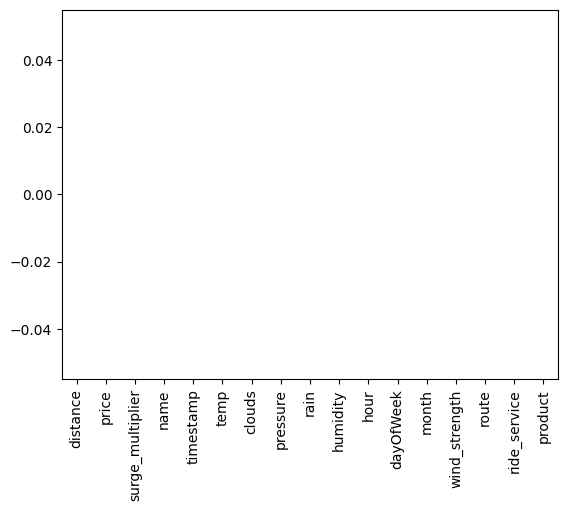

In [ ]:
(df
 .isnull()
 .sum()
 .plot(kind="bar")
 )

In [ ]:
df = pd.concat([df, pd.get_dummies(df["product"])], axis=1
)
df

,distance,price,surge_multiplier,name,timestamp,temp,clouds,pressure,rain,humidity,...,wind_strength,route,ride_service,product,accessible,luxury,shared,standard,suv,xl
0,0.44,5.0,1.0,Shared,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,...,3.0,Haymarket Square-North Station,0,shared,0,0,1,0,0,0
1,0.44,11.0,1.0,Lux,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,...,3.0,Haymarket Square-North Station,0,luxury,0,1,0,0,0,0
2,0.44,7.0,1.0,Lyft,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,...,3.0,Haymarket Square-North Station,0,standard,0,0,0,1,0,0
3,0.44,26.0,1.0,Lux Black XL,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,...,3.0,Haymarket Square-North Station,0,suv,0,0,0,0,1,0
4,0.44,9.0,1.0,Lyft XL,2018-12-16 09:30:07.890,3.588889,0.29,1022.25,0.0,0.76,...,3.0,Haymarket Square-North Station,0,xl,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
635235,1.00,9.5,1.0,WAV,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,...,1.0,West End-North End,1,accessible,1,0,0,0,0,0
635236,1.00,13.0,1.0,UberXL,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,...,1.0,West End-North End,1,xl,0,0,0,0,0,1
635237,1.00,9.5,1.0,UberX,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,...,1.0,West End-North End,1,standard,0,0,0,1,0,0
635238,1.00,27.0,1.0,Black SUV,2018-12-01 23:53:05.534,2.605556,0.41,1023.64,0.0,0.76,...,1.0,West End-North End,1,suv,0,0,0,0,1,0


In [ ]:
# df.info()
df = (df
      .drop(["name","timestamp","route","product"], axis=1))
df

,distance,price,surge_multiplier,temp,clouds,pressure,rain,humidity,hour,dayOfWeek,month,wind_strength,ride_service,accessible,luxury,shared,standard,suv,xl
0,0.44,5.0,1.0,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,0,0,0,1,0,0,0
1,0.44,11.0,1.0,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,0,0,1,0,0,0,0
2,0.44,7.0,1.0,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,0,0,0,0,1,0,0
3,0.44,26.0,1.0,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,0,0,0,0,0,1,0
4,0.44,9.0,1.0,3.588889,0.29,1022.25,0.0,0.76,9,6,12,3.0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
635235,1.00,9.5,1.0,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,1,1,0,0,0,0,0
635236,1.00,13.0,1.0,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,1,0,0,0,0,0,1
635237,1.00,9.5,1.0,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,1,0,0,0,1,0,0
635238,1.00,27.0,1.0,2.605556,0.41,1023.64,0.0,0.76,23,5,12,1.0,1,0,0,0,0,1,0


- create correlation datafrme
- extract the target variable correlations - price

In [ ]:
corr_df = df.corr()
# extract price
price_corr = corr_df["price"].sort_values()
price_corr

shared             -0.436668
standard           -0.328714
accessible         -0.223537
ride_service       -0.083393
xl                 -0.049998
wind_strength      -0.022177
humidity           -0.018799
rain               -0.000041
clouds              0.000825
temp                0.003323
month               0.027875
hour                0.029705
dayOfWeek           0.036787
pressure            0.042449
luxury              0.240104
surge_multiplier    0.240824
distance            0.345055
suv                 0.706027
price               1.000000
Name: price, dtype: float64

In [ ]:
fig = px.imshow(df.corr(), text_auto=True)
fig.update_layout(
    height=900,
    width=950
)
fig.show()


In [ ]:
fig = go.Figure()
fig.add_trace(
    go.Bar(x=price_corr.index, y= price_corr.values, text=price_corr.values)
)
fig.update_layout(
      plot_bgcolor="white",
      height=900,
      width=950,
      margin={
          "l":25,
          "r":25,
          "b":25
      },
      title_text="Price Correlation Distribution <br>",
      title={
          "x":0.5,
          "xanchor":"center",
          "font":{
              "size":14
          }
      },
      xaxis_title="Ride Provider",
      showlegend=False
  )
fig.update_xaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.update_yaxes(
      showline = True,
      linewidth=1,
      linecolor="black"
  )
fig.show()

# Modelling

Let's create a regression model to determine the price when given some input parameters.


In [ ]:
from sklearn.metrics import r2_score
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import train_test_split, cross_val_score, KFold, GridSearchCV
from sklearn.preprocessing import MinMaxScaler, PowerTransformer
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler, PowerTransformer

 - load the data
 For the linear regression example, we will look to predict price (target) with one feature (distance)

In [ ]:
# feature
X = np.array(df["distance"]).reshape(-1,1)
# target
y = np.array(df["price"]).reshape(-1,1)



- **split the data**


In [ ]:
# perform data splitting
X_train, X_val, y_train, y_val = train_test_split(X,y, test_size=0.2, random_state=22)

- **create and train the model**

In [ ]:
# create model
model = LinearRegression()
# fit (or train) model
model.fit(X_train, y_train)

- **make predictions**

In [ ]:
  # make predictions
val_pred = model.predict(X_val)
# evaluate predictions with r2_score
val_r2 = r2_score(y_val, val_pred)

- Plot the Predicted vs Actual Graph

In [ ]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(x=y_val.reshape(len(y_val)), y=val_pred.reshape(len(val_pred)), mode="markers")
)

fig.update_layout(
  plot_bgcolor="white",
  height=900,
  width=950,
  margin={
      "l":25,
      "r":25,
      "b":25
  },
  title_text="Linear Regression prediction <br>",
  title={
      "x":0.5,
      "xanchor":"center",
      "font":{
          "size":14
      }
  },
  xaxis_title="Actual Price",
  yaxis_title="Predicted Price",
  showlegend=False
)
fig.update_xaxes(
  showline = True,
  linewidth=1,
  linecolor="black"
)
fig.update_yaxes(
  showline = True,
  linewidth=1,
  linecolor="black"
)
fig.show()

## Model Quality Evaluation

- Get regression model summary using the **statsmodels** package

In [ ]:
import statsmodels.api as sm

In [ ]:
# add constant to feature variables
x = sm.add_constant(X_train)
# fit the linear regression model
model_sm = sm.OLS(y_train, x).fit()
# view model summarry
print(model_sm.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.119
Model:                            OLS   Adj. R-squared:                  0.119
Method:                 Least Squares   F-statistic:                 6.880e+04
Date:                Fri, 02 Feb 2024   Prob (F-statistic):               0.00
Time:                        07:51:54   Log-Likelihood:            -1.8238e+06
No. Observations:              508192   AIC:                         3.648e+06
Df Residuals:                  508190   BIC:                         3.648e+06
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         10.3451      0.027    387.826      0.0

$$\hat Price = 10.3451 + 2.8364*Distance$$

The `std err` column represents the statistical *standard error* for each of the coefficients. A good model should havea std error that is at least 5 to 10 times smaller than the corresponding coefficient. This ratio is reffered to as the *t-statistic*. The **larger the ratio between std err and coefficent, the less variablility** in the slope of the estimate.

The `P>|t|` column represents the probability of observing a *t-statistic* as extreme or more extreme as the one observed - assumming there is **no** linear relationship between the predictor and response variable.

From the summary plot above:
- $R^{2}$: 0.119 - 11.9% of the variability in the price of ride hailing trips is determined by the distance. This would be a good value if we didnt have access to other features. We will use *multiple* linear regression model and see if we can improve on this.

### Residual Analysis
The summary plot gives a significant amount of information to assist in the evaluation of a regression model's training. However, there is additional tool that can be used such - as comparing the true values compared to the model predictions. This is where *residual analysis** comes in.



> A residual is the difference between the actual value and the model's prediction.

Residual values **larger than the zero**indicate that the model predicted a value larger than truth value (**over-predict**) and a residual values **smaller than zero** indicate model predicted a value smaller than truth value (**under-predict**). A **well-trained** model tends to have **no bias** to either over-prediction or under-prediction. That is, the residuals should be **normally distributed** around zero.

Let us plot the residuals of our prediction.


In [ ]:
# calculate residuals
residuals = val_pred - y_val
residuals = residuals.reshape(len(residuals))

In [ ]:
fig = go.Figure()

fig.add_trace(
    go.Scatter(x=y_val.reshape(len(y_val)), y=residuals, mode="markers")
)

fig.update_layout(
  plot_bgcolor="white",
  height=900,
  width=950,
  margin={
      "l":25,
      "r":25,
      "b":25
  },
  title_text="Price prediction residuals <br>",
  title={
      "x":0.5,
      "xanchor":"center",
      "font":{
          "size":14
      }
  },
  xaxis_title="Price predictions",
  yaxis_title="Residuals",
  showlegend=False
)
fig.update_xaxes(
  showline = True,
  linewidth=1,
  linecolor="black"
)
fig.update_yaxes(
  showline = True,
  linewidth=1,
  linecolor="black"
)
fig.show()

- From the graph above we observe the following:
 - residuals are not uniformly scattered around zero
 - there is a clear negative trend - as the price increases get higher our model is under-predicting
 - overall, this plot shows us that using distance as our only feature in determing price is not a sufficient

 When performing residual analysis, if there is any clear trend or pattern in the residuals, the model should be **improved**.

 A **quantile-versus-quantile**, or **Q-Q** plot is another tool that we can use for residual analysis. The Q-Q plot is a good visualisation for checking if the residuals are normally distributed.

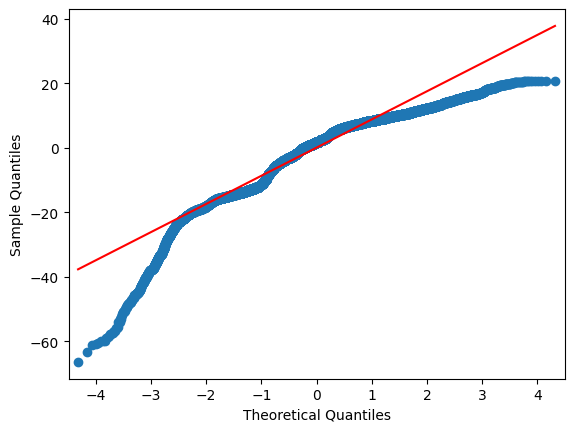

In [ ]:
qqplot_res = sm.qqplot(residuals, line="s").gca().lines
plt.show()

A normally distributed residuals would follow the straight line in the Q-Q plot. However, the two-ends of the Q-Q plot diverge away from the line - therefore residuals are not normally distributed. The plot further confirms that distance should not be the only predictor used to predict price.